# CNN Trainig Templete
## Based on Tensorlfow - CNN MNIST example
https://github.com/tensorflow/tensorflow/blob/r1.6/tensorflow/examples/tutorials/layers/cnn_mnist.py

## 필요한 library 호출

In [1]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import tensorflow as tf
import numpy as np
import cv2
import os
import matplotlib.pyplot as plt
import random
from sklearn.cross_validation import train_test_split
from datetime import datetime

tf.logging.set_verbosity(tf.logging.INFO)


/usr/local/lib/python3.5/dist-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
/usr/local/lib/python3.5/dist-packages/sklearn/cross_validation.py:41: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


In [2]:
def cnn_model_fn(features, labels, mode):
    
    """Model function for CNN."""
    # Input Layer
    # Reshape X to 4-D tensor: [batch_size, height, width, channels]
    # Our Fishing net image size is 640x480 and 3-channel (RGB)
    input_layer = tf.reshape(features["x"], [-1, 480, 640, 3])

    # Convolutional Layer #1
    # Computes 48 features using a 5x5 filter with ReLU activation.
    # Padding is added to preserve width and height.
    # Input Tensor Shape: [batch_size, 480, 640, 3]
    # Output Tensor Shape: [batch_size, 480, 640, 48]
    conv1 = tf.layers.conv2d(
        
        inputs=input_layer,
        filters=48,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    #print(conv1.shape)

    # Pooling Layer #1
    # First max pooling layer with a 2x2 filter and stride of 2
    # Input Tensor Shape: [batch_size, 480, 640, 48]
    # Output Tensor Shape: [batch_size, 240, 320, 48]
    pool1 = tf.layers.max_pooling2d(inputs=conv1, pool_size=[2, 2], strides=2)
    #print(pool1.shape)

    # Convolutional Layer #2
    # Computes 96 features using a 5x5 filter.
    # Padding is added to preserve width and height.
    # Input Tensor Shape: [batch_size, 240, 320, 48]
    # Output Tensor Shape: [batch_size, 240, 320, 96]
    conv2 = tf.layers.conv2d(
        inputs=pool1,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    #print(conv2.shape)

    # Pooling Layer #2
    # Second max pooling layer with a 2x2 filter and stride of 2
    # Input Tensor Shape: [batch_size, 240, 320, 96]
    # Output Tensor Shape: [batch_size, 120, 160, 96]
    pool2 = tf.layers.max_pooling2d(inputs=conv2, pool_size=[2, 2], strides=2)
    #print(pool2.shape)

    
    
    
    # Input Tensor Shape: [batch_size, 120, 160, 96]
    # Output Tensor Shape: [batch_size, 120, 160, 96]    
    conv3 = tf.layers.conv2d(
        inputs=pool2,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    #print(conv3.shape)
    
    # Input Tensor Shape: [batch_size, 120, 160, 96]
    # Output Tensor Shape: [batch_size, 60, 80, 96]
    pool3 = tf.layers.max_pooling2d(inputs=conv3, pool_size=[2, 2], strides=2)
    #print(pool3.shape)
    
    
    
    # Input Tensor Shape: [batch_size, 60, 80, 96]
    # Output Tensor Shape: [batch_size, 60, 80, 96]    
    conv4 = tf.layers.conv2d(
        inputs=pool3,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    #print(conv4.shape)
    
    # Input Tensor Shape: [batch_size, 60, 80, 96]
    # Output Tensor Shape: [batch_size, 30, 40, 96]
    pool4 = tf.layers.max_pooling2d(inputs=conv4, pool_size=[2, 2], strides=2)
    #print(pool4.shape)
    
    
    
    # Input Tensor Shape: [batch_size, 30, 40, 96]
    # Output Tensor Shape: [batch_size, 30, 40, 96]    
    conv5 = tf.layers.conv2d(
        inputs=pool4,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    #print(conv5.shape)
    
    # Input Tensor Shape: [batch_size, 30, 40, 96]
    # Output Tensor Shape: [batch_size, 15, 20, 96]
    pool5 = tf.layers.max_pooling2d(inputs=conv5, pool_size=[2, 2], strides=2)
    #print(pool5.shape)
    
    
    
    
    # Flatten tensor into a batch of vectors
    # Input Tensor Shape: [batch_size, 15, 20, 96]
    # Output Tensor Shape: [batch_size, 15 * 20 * 96]
    pool5_flat = tf.reshape(pool5, [-1, 15 * 20 * 96])
    #print(pool5_flat.shape)


    # Dense Layer
    # Densely connected layer with 1024 neurons
    # Input Tensor Shape: [batch_size, 15 * 20 * 96]
    # Output Tensor Shape: [batch_size, 1024]
    dense = tf.layers.dense(inputs=pool5_flat, units=1024, activation=tf.nn.relu)
    #print(dense.shape)

    # Add dropout operation; 0.6 probability that element will be kept
    dropout = tf.layers.dropout(
        inputs=dense, rate=0.4, training=mode == tf.estimator.ModeKeys.TRAIN)

    # Logits layer
    # Input Tensor Shape: [batch_size, 1024]
    # Output Tensor Shape: [batch_size, 1]
    logits = tf.layers.dense(inputs=dropout, units=2)
    #print(logits.shape)

    predictions = {
        # Generate predictions (for PREDICT and EVAL mode)
        "classes": tf.argmax(input=logits, axis=1),
        # Add `softmax_tensor` to the graph. It is used for PREDICT and by the
        # `logging_hook`.
        "probabilities": tf.nn.softmax(logits, name="softmax_tensor")
    }
    if mode == tf.estimator.ModeKeys.PREDICT:
        return tf.estimator.EstimatorSpec(mode=mode, predictions=predictions)

    # Calculate Loss (for both TRAIN and EVAL modes)
    loss = tf.losses.sparse_softmax_cross_entropy(labels=labels, logits=logits)
    # sparse_softmax_cross_entropy cannot use one-hot encoding
    
    #loss = tf.nn.sigmoid_cross_entropy_with_logits(labels=labels, logits=logits)

    # Configure the Training Op (for TRAIN mode)
    if mode == tf.estimator.ModeKeys.TRAIN:
        optimizer = tf.train.GradientDescentOptimizer(learning_rate=0.001)
        train_op = optimizer.minimize(
            loss=loss,
            global_step=tf.train.get_global_step())
        return tf.estimator.EstimatorSpec(mode=mode, loss=loss, train_op=train_op)

    # Add evaluation metrics (for EVAL mode)
    eval_metric_ops = {
        "accuracy": tf.metrics.accuracy(
            labels=labels, predictions=predictions["classes"])}
    return tf.estimator.EstimatorSpec(
        mode=mode, loss=loss, eval_metric_ops=eval_metric_ops)

In [3]:
def data_process(d_dir, split_rate):
    
    num_class = len(d_dir.keys())

    out = {}
    

    for i in range(num_class):
        x_train, x_test = train_test_split(d_dir[i], test_size=split_rate)
        
        if i == 0:
            train_temp = x_train
            test_temp = x_test
        else:
            train_temp.extend(x_train)
            test_temp.extend(x_test)
    
    random.shuffle(train_temp)
    out['train'] = train_temp
    random.shuffle(test_temp)
    out['test'] = test_temp
    
    return out
        

## Code Run


### Training
Batch size: 128  
Epoch: 5  
Shuffle: True  
Step: 20000

## Loading dataset
Load dataset and split them into training data and evaluation data

In [4]:
image_dir1 = '/dataset/'
class_name1 = ['untorn', 'torn']

data_dir1 = {}
for i in range(len(class_name1)):
    temp_dir = image_dir1 + class_name1[i]
    img_files = [[os.path.join(temp_dir, f), np.int16(i)] for f in os.listdir(temp_dir) if f.endswith('.png')]
    data_dir1[i] = img_files
print(len(data_dir1[0]))

1780


In [5]:
image_dir2 = './data_oh/train-images/train-images_128/'
class_name2 = ['bite', 'cut', 'normal']

data_dir2 = {}

for i in range(len(class_name2)):
    temp_dir = image_dir2 + class_name2[i]
    
    if i == 2:
        label=0
    else:
        label=1
    img_files = [[os.path.join(temp_dir, f), np.int16(label)] for f in os.listdir(temp_dir) if f.endswith('.png')]
    data_dir2[i] = img_files
print(len(data_dir2[0]))

85


In [6]:
image_dir3 = './data_oh/test-images/test-images_128/'
class_name3 = ['bite', 'cut', 'normal']

data_dir3 = {}

for i in range(len(class_name3)):
    temp_dir = image_dir3 + class_name3[i]
    
    if i == 2:
        label=0
    else:
        label=1
    img_files = [[os.path.join(temp_dir, f), np.int16(label)] for f in os.listdir(temp_dir) if f.endswith('.png')]
    data_dir3[i] = img_files
print(len(data_dir3[0]))

25


In [7]:
tr_data_dir = data_process(data_dir1, 0.2)

In [8]:
tr_temp = tr_data_dir['train']
tr_temp.extend(data_dir2[2])
tr_temp.extend(data_dir2[1])
tr_temp.extend(data_dir2[0])
random.shuffle(tr_temp)
print(tr_temp)

[['/dataset/untorn/img-1045.png', 0], ['/dataset/torn/img-1252.png', 1], ['/dataset/untorn/img-1240.png', 0], ['/dataset/untorn/img-1310.png', 0], ['./data_oh/train-images/train-images_128/bite/frame5.png', 1], ['/dataset/untorn/img-0222.png', 0], ['/dataset/torn/img-1354.png', 1], ['/dataset/torn/img-0592.png', 1], ['/dataset/torn/img-0589.png', 1], ['/dataset/untorn/img-1546.png', 0], ['/dataset/untorn/img-0995.png', 0], ['/dataset/untorn/img-0077.png', 0], ['/dataset/untorn/img-0658.png', 0], ['/dataset/untorn/img-1132.png', 0], ['/dataset/untorn/img-1173.png', 0], ['/dataset/untorn/img-0886.png', 0], ['/dataset/torn/img-0499.png', 1], ['/dataset/untorn/img-0301.png', 0], ['/dataset/untorn/img-0086.png', 0], ['/dataset/untorn/img-0829.png', 0], ['/dataset/torn/img-1123.png', 1], ['/dataset/untorn/img-0055.png', 0], ['./data_oh/train-images/train-images_128/cut/frame65.png', 1], ['/dataset/torn/img-0093.png', 1], ['/dataset/untorn/img-0705.png', 0], ['./data_oh/train-images/train-ima

In [9]:
print(len(tr_temp))
tr_data_dir['train'] = tr_temp
print(len(tr_data_dir['train']), len(tr_data_dir['test']))

2867
2867 653


In [10]:
te_data_dir = data_dir3[0]
te_data_dir.extend(data_dir3[1])
te_data_dir.extend(data_dir3[2])
print(te_data_dir)

[['./data_oh/test-images/test-images_128/bite/frame89.png', 1], ['./data_oh/test-images/test-images_128/bite/frame80.png', 1], ['./data_oh/test-images/test-images_128/bite/frame86.png', 1], ['./data_oh/test-images/test-images_128/bite/frame90.png', 1], ['./data_oh/test-images/test-images_128/bite/frame61.png', 1], ['./data_oh/test-images/test-images_128/bite/frame92.png', 1], ['./data_oh/test-images/test-images_128/bite/frame94.png', 1], ['./data_oh/test-images/test-images_128/bite/frame84.png', 1], ['./data_oh/test-images/test-images_128/bite/frame88.png', 1], ['./data_oh/test-images/test-images_128/bite/frame62.png', 1], ['./data_oh/test-images/test-images_128/bite/frame77.png', 1], ['./data_oh/test-images/test-images_128/bite/frame79.png', 1], ['./data_oh/test-images/test-images_128/bite/frame76.png', 1], ['./data_oh/test-images/test-images_128/bite/frame78.png', 1], ['./data_oh/test-images/test-images_128/bite/frame81.png', 1], ['./data_oh/test-images/test-images_128/bite/frame75.p

In [11]:
im_width = 640
im_height = 480
num_chan = 3
total_pix = im_width * im_height * num_chan

In [12]:
tr_data = np.zeros((len(tr_data_dir['train']), total_pix), dtype=np.float32)
tr_label = np.zeros((len(tr_data_dir['train']), 1), dtype=np.int32)

In [13]:
for i in range(len(tr_data_dir['train'])):
    img = cv2.imread(tr_data_dir['train'][i][0])
    tr_data[i][:] = cv2.resize(img, (im_width, im_height), interpolation=cv2.INTER_CUBIC).flatten()
    tr_label[i] = tr_data_dir['train'][i][1]

In [14]:
ev_data = np.zeros((len(tr_data_dir['test']), total_pix), dtype=np.float32)
ev_label = np.zeros((len(tr_data_dir['test']), 1), dtype=np.int32)

for i in range(len(tr_data_dir['test'])):
    img = cv2.imread(tr_data_dir['test'][i][0])
    ev_data[i][:] = cv2.resize(img, (im_width, im_height), interpolation=cv2.INTER_CUBIC).flatten()
    ev_label[i] = tr_data_dir['test'][i][1]

Batch 16  
Epoch 45  
Training steps 7400

In [15]:
today = datetime.today().strftime("%Y-%m-%d-%H-%M-%S")
print(today)

2018-05-02-07-30-42


In [17]:
config = tf.ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.7
session = tf.Session(config=config)

# Create the Estimator
net_classifier = tf.estimator.Estimator(
    model_fn=cnn_model_fn, model_dir="/models/CNN2600_blend_%s" % today)

# Set up logging for predictions
# Log the values in the "Softmax" tensor with label "probabilities"
tensors_to_log = {"probabilities": "softmax_tensor"}
logging_hook = tf.train.LoggingTensorHook(
    tensors=tensors_to_log, every_n_iter=50)

batch_s = 16
epochs = 15
tr_steps = int(tr_data.shape[0]/batch_s*epochs)
in_steps = 1
print(tr_steps)

for d in ['/device:GPU:0', '/device:GPU:1', '/device:GPU:2']:
    with tf.device(d):

        # Train the model
        train_input_fn = tf.estimator.inputs.numpy_input_fn(
            x={"x": tr_data},
            y=tr_label,
            batch_size=batch_s,
            num_epochs=epochs,
            shuffle=True)
        net_classifier.train(
            input_fn=train_input_fn,
            steps=tr_steps,
            hooks=[logging_hook])

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_keep_checkpoint_max': 5, '_save_checkpoints_secs': 600, '_num_ps_replicas': 0, '_service': None, '_save_checkpoints_steps': None, '_global_id_in_cluster': 0, '_log_step_count_steps': 100, '_master': '', '_session_config': None, '_task_id': 0, '_is_chief': True, '_model_dir': '/models/CNN2600_blend_2018-05-02-07-30-42', '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x7fee18097940>, '_save_summary_steps': 100, '_num_worker_replicas': 1, '_tf_random_seed': None, '_task_type': 'worker', '_keep_checkpoint_every_n_hours': 10000, '_evaluation_master': ''}
2687
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Create CheckpointSaverHook.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Saving checkpoints for 1 into /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt.


INFO:tensorflow:loss = 0.49296236, step = 701 (28.629 sec)
INFO:tensorflow:probabilities = [[0.3312843  0.6687157 ]
 [0.30611846 0.6938816 ]
 [0.5428701  0.4571299 ]
 [0.21666732 0.7833327 ]
 [0.80241174 0.19758828]
 [0.21957402 0.78042597]
 [0.5458561  0.45414388]
 [0.6062891  0.3937109 ]
 [0.732748   0.26725206]
 [0.5670838  0.4329162 ]
 [0.5046425  0.4953575 ]
 [0.5948855  0.40511447]
 [0.5883657  0.41163433]
 [0.4780566  0.5219434 ]
 [0.67571396 0.324286  ]
 [0.6956531  0.30434695]] (14.134 sec)
INFO:tensorflow:global_step/sec: 3.53215
INFO:tensorflow:probabilities = [[0.38458437 0.6154156 ]
 [0.4670554  0.53294456]
 [0.66229415 0.33770582]
 [0.8715842  0.12841587]
 [0.3924878  0.60751224]
 [0.34196386 0.6580362 ]
 [0.61479855 0.38520145]
 [0.42191318 0.57808685]
 [0.37546396 0.62453604]
 [0.6434919  0.35650814]
 [0.3410235  0.65897655]
 [0.4150855  0.5849145 ]
 [0.5079227  0.49207723]
 [0.8067099  0.19329014]
 [0.6014151  0.3985849 ]
 [0.6598564  0.3401436 ]] (14.178 sec)
INFO:ten

INFO:tensorflow:global_step/sec: 3.50649
INFO:tensorflow:probabilities = [[0.88354725 0.11645278]
 [0.92822576 0.0717743 ]
 [0.4013364  0.5986636 ]
 [0.9088998  0.09110016]
 [0.19927791 0.80072206]
 [0.9563099  0.04369007]
 [0.8432666  0.15673336]
 [0.72877616 0.27122384]
 [0.6882088  0.3117912 ]
 [0.6403156  0.35968438]
 [0.6201191  0.37988093]
 [0.8566101  0.14338988]
 [0.42618585 0.57381415]
 [0.52136064 0.47863933]
 [0.6601535  0.33984652]
 [0.41751048 0.58248955]] (14.314 sec)
INFO:tensorflow:loss = 0.51415217, step = 1601 (28.519 sec)
INFO:tensorflow:probabilities = [[0.5030715  0.4969285 ]
 [0.6268108  0.3731892 ]
 [0.8116768  0.18832324]
 [0.22505702 0.77494293]
 [0.69135326 0.30864674]
 [0.80963063 0.19036937]
 [0.22619441 0.77380556]
 [0.3134328  0.6865672 ]
 [0.08741795 0.912582  ]
 [0.8411256  0.15887444]
 [0.2290329  0.7709671 ]
 [0.8653376  0.13466236]
 [0.26477754 0.73522246]
 [0.5678712  0.43212876]
 [0.92083764 0.07916234]
 [0.23497345 0.76502657]] (14.212 sec)
INFO:te

INFO:tensorflow:loss = 0.57353544, step = 2401 (28.509 sec)
INFO:tensorflow:probabilities = [[0.35421622 0.64578384]
 [0.701416   0.29858398]
 [0.72185004 0.27814993]
 [0.79376584 0.20623417]
 [0.34652972 0.6534702 ]
 [0.7571771  0.24282283]
 [0.36097756 0.63902247]
 [0.27689448 0.7231055 ]
 [0.9376523  0.06234768]
 [0.07771727 0.92228276]
 [0.6315959  0.3684041 ]
 [0.75904495 0.24095502]
 [0.59578115 0.40421888]
 [0.43214422 0.56785583]
 [0.21579015 0.78420985]
 [0.16744466 0.83255535]] (14.368 sec)
INFO:tensorflow:global_step/sec: 3.48954
INFO:tensorflow:probabilities = [[0.78001153 0.2199885 ]
 [0.41211566 0.5878843 ]
 [0.6388493  0.36115065]
 [0.78782034 0.21217962]
 [0.01942438 0.9805757 ]
 [0.30099967 0.69900036]
 [0.3252633  0.6747367 ]
 [0.6560352  0.34396484]
 [0.14189902 0.85810095]
 [0.88017035 0.11982969]
 [0.794314   0.205686  ]
 [0.07171244 0.92828757]
 [0.8616483  0.1383517 ]
 [0.644753   0.35524705]
 [0.1433227  0.8566773 ]
 [0.17418005 0.82581997]] (14.289 sec)
INFO:te

INFO:tensorflow:loss = 0.4286874, step = 3188 (28.553 sec)
INFO:tensorflow:probabilities = [[0.7091211  0.2908789 ]
 [0.01996468 0.98003525]
 [0.9052156  0.09478434]
 [0.77619183 0.22380811]
 [0.02970511 0.9702949 ]
 [0.7770329  0.22296706]
 [0.9263914  0.07360853]
 [0.66221404 0.33778602]
 [0.92199963 0.07800039]
 [0.91932905 0.08067094]
 [0.9710694  0.02893063]
 [0.53838354 0.46161646]
 [0.13755697 0.86244303]
 [0.24842216 0.7515778 ]
 [0.27581286 0.72418714]
 [0.9672277  0.03277231]] (14.281 sec)
INFO:tensorflow:global_step/sec: 3.50161
INFO:tensorflow:probabilities = [[0.9497011  0.05029888]
 [0.85220075 0.14779927]
 [0.4890065  0.51099354]
 [0.73269415 0.26730585]
 [0.03076688 0.9692331 ]
 [0.972703   0.02729704]
 [0.91691023 0.08308978]
 [0.8363917  0.16360831]
 [0.03374384 0.96625614]
 [0.9874857  0.01251425]
 [0.24633999 0.75365996]
 [0.70097053 0.29902953]
 [0.5161468  0.48385328]
 [0.8552051  0.14479485]
 [0.8565739  0.14342609]
 [0.9420678  0.05793216]] (14.278 sec)
INFO:ten

INFO:tensorflow:global_step/sec: 3.51138
INFO:tensorflow:probabilities = [[0.01391611 0.9860839 ]
 [0.98534274 0.01465732]
 [0.00054943 0.9994506 ]
 [0.2309136  0.7690864 ]
 [0.90830624 0.09169369]
 [0.15082283 0.8491772 ]
 [0.6730673  0.32693276]
 [0.03040444 0.96959555]
 [0.5514002  0.44859976]
 [0.9741261  0.0258739 ]
 [0.59150636 0.40849367]
 [0.51217973 0.4878202 ]
 [0.9424819  0.05751811]
 [0.99402857 0.00597139]
 [0.00721202 0.992788  ]
 [0.3491265  0.65087354]] (14.335 sec)
INFO:tensorflow:loss = 0.21888971, step = 4088 (28.481 sec)
INFO:tensorflow:probabilities = [[0.22509608 0.77490395]
 [0.05645731 0.9435427 ]
 [0.9825739  0.01742607]
 [0.04286677 0.9571333 ]
 [0.94981724 0.05018276]
 [0.04472116 0.9552788 ]
 [0.99565876 0.00434122]
 [0.9902942  0.00970581]
 [0.2824463  0.7175537 ]
 [0.75273263 0.2472674 ]
 [0.21457162 0.78542835]
 [0.67216986 0.32783017]
 [0.00186403 0.9981359 ]
 [0.00971644 0.99028355]
 [0.9023147  0.09768528]
 [0.6615456  0.33845446]] (14.347 sec)
INFO:te

INFO:tensorflow:loss = 0.23133862, step = 4888 (28.595 sec)
INFO:tensorflow:probabilities = [[0.5533919  0.44660813]
 [0.76507384 0.23492613]
 [0.81146413 0.18853584]
 [0.42735168 0.57264835]
 [0.6593504  0.34064955]
 [0.99974364 0.0002563 ]
 [0.60147893 0.3985211 ]
 [0.01111278 0.98888725]
 [0.00012101 0.999879  ]
 [0.49485093 0.50514907]
 [0.10846713 0.8915329 ]
 [0.85431015 0.14568985]
 [0.5409097  0.45909032]
 [0.36284032 0.6371597 ]
 [0.6719707  0.32802927]
 [0.10139077 0.8986092 ]] (14.075 sec)
INFO:tensorflow:global_step/sec: 3.51773
INFO:tensorflow:probabilities = [[0.08261222 0.91738784]
 [0.00137171 0.99862826]
 [0.25880373 0.74119633]
 [0.9650292  0.03497076]
 [0.05086762 0.9491323 ]
 [0.99031365 0.00968639]
 [0.9591976  0.04080236]
 [0.36424297 0.635757  ]
 [0.99904674 0.00095329]
 [0.5593248  0.44067523]
 [0.00111607 0.9988839 ]
 [0.1174541  0.88254595]
 [0.59556705 0.40443298]
 [0.9945227  0.00547729]
 [0.18042544 0.8195746 ]
 [0.9170746  0.08292545]] (14.352 sec)
INFO:te

INFO:tensorflow:loss = 0.2456746, step = 5675 (28.544 sec)
INFO:tensorflow:probabilities = [[0.53553545 0.46446452]
 [0.00068248 0.9993175 ]
 [0.9690981  0.03090188]
 [0.8283788  0.1716212 ]
 [0.98956734 0.01043265]
 [0.92036057 0.07963948]
 [0.9365713  0.06342872]
 [0.98555714 0.01444292]
 [0.98504454 0.01495549]
 [0.9344658  0.06553414]
 [0.33179986 0.6682001 ]
 [0.99678975 0.00321024]
 [0.35668454 0.6433155 ]
 [0.12494149 0.8750585 ]
 [0.7407703  0.25922972]
 [0.99915314 0.00084683]] (14.265 sec)
INFO:tensorflow:global_step/sec: 3.5057
INFO:tensorflow:probabilities = [[0.23299158 0.76700836]
 [0.97480667 0.02519333]
 [0.97533596 0.024664  ]
 [0.9805437  0.01945629]
 [0.02333262 0.9766674 ]
 [0.70400375 0.29599628]
 [0.5670411  0.4329589 ]
 [0.4401595  0.55984056]
 [0.02196381 0.9780362 ]
 [0.02963666 0.9703634 ]
 [0.7686965  0.23130347]
 [0.64704084 0.3529592 ]
 [0.5833105  0.41668954]
 [0.9737906  0.02620937]
 [0.932869   0.06713096]
 [0.34817752 0.6518225 ]] (14.260 sec)
INFO:tens

INFO:tensorflow:global_step/sec: 3.50781
INFO:tensorflow:probabilities = [[0.8815302  0.11846977]
 [0.28389242 0.7161076 ]
 [0.00001385 0.9999862 ]
 [0.01125138 0.98874867]
 [0.9982566  0.00174343]
 [0.98218614 0.01781389]
 [0.80244565 0.19755433]
 [0.2973271  0.7026729 ]
 [0.72113496 0.27886504]
 [0.99821067 0.00178934]
 [0.9236859  0.07631408]
 [0.9970765  0.00292355]
 [0.08169559 0.91830444]
 [0.9951121  0.00488786]
 [0.42304754 0.57695246]
 [0.07747018 0.9225298 ]] (14.347 sec)
INFO:tensorflow:loss = 0.34783995, step = 6575 (28.508 sec)
INFO:tensorflow:probabilities = [[0.13606963 0.86393034]
 [0.9977597  0.00224033]
 [0.02622178 0.97377825]
 [0.86268425 0.13731575]
 [0.9974746  0.00252536]
 [0.0000082  0.9999918 ]
 [0.5903618  0.40963823]
 [0.6801636  0.3198364 ]
 [0.00000002 1.        ]
 [0.00350485 0.9964952 ]
 [0.02874588 0.9712541 ]
 [0.98894405 0.01105593]
 [0.16095069 0.83904934]
 [0.99893373 0.00106626]
 [0.2914318  0.70856816]
 [0.62030005 0.37969992]] (14.244 sec)
INFO:te

INFO:tensorflow:loss = 0.17993014, step = 7375 (28.534 sec)
INFO:tensorflow:probabilities = [[0.4306239  0.5693761 ]
 [0.18854786 0.81145215]
 [0.99943763 0.00056236]
 [0.61758167 0.3824183 ]
 [0.89078283 0.10921714]
 [0.25614926 0.7438507 ]
 [0.01317154 0.98682845]
 [0.1751507  0.82484925]
 [0.5971523  0.4028477 ]
 [0.5671647  0.4328353 ]
 [0.8964162  0.10358381]
 [0.17908213 0.8209179 ]
 [0.01400537 0.9859947 ]
 [0.9997023  0.00029771]
 [0.26100242 0.7389975 ]
 [0.42977434 0.57022566]] (14.148 sec)
INFO:tensorflow:Saving checkpoints for 7474 into /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt.
INFO:tensorflow:global_step/sec: 3.50629
INFO:tensorflow:probabilities = [[0.99098855 0.00901145]
 [0.9977028  0.0022972 ]
 [0.20057985 0.7994201 ]
 [0.08737864 0.91262144]
 [0.9906352  0.00936479]
 [0.99973315 0.0002669 ]
 [0.4832121  0.5167879 ]
 [0.00553106 0.9944689 ]
 [0.1494876  0.8505124 ]
 [0.9997002  0.00029987]
 [0.5056467  0.49435326]
 [0.9840517  0.01594824]
 [0.06390798 0.936

In [18]:
config = tf.ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.8
session = tf.Session(config=config)

ev_results = np.zeros((len(ev_label), 1))
with tf.device('/device:GPU:3'):

    # Evaluate the model and print results
    for i in range(len(ev_label)):
        eval_input_fn = tf.estimator.inputs.numpy_input_fn(
            x={"x": ev_data[i:i+1]},
            y=ev_label[i:i+1],
            num_epochs=1,
            shuffle=False)
        eval_results = net_classifier.evaluate(input_fn=eval_input_fn)
        
        ev_results[i] = eval_results["accuracy"]

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:11:36
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:11:37
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.02831452
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:11:37
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:11:37
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_s

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:11:43
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:11:43
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.21809801
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:11:44
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:11:44
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_s

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:11:50
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:11:50
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.0027932222
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:11:50
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:11:51
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:11:56
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:11:57
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.17790578
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:11:57
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:11:57
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_s

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:03
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:04
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.00042191186
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:04
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:04
INFO:tensorflow:Saving dict for global step 8061: accuracy = 0.0, globa

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:10
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:10
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.0030147838
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:10
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:11
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:17
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:17
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.24864176
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:17
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:18
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_s

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:24
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:24
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.0020284331
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:24
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:24
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:30
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:31
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.011771031
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:31
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:31
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:37
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:38
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 1.2755313e-05
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:38
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:38
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, globa

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:44
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:45
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.00053987233
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:45
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:45
INFO:tensorflow:Saving dict for global step 8061: accuracy = 0.0, globa

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:51
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:51
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.00010835537
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:52
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:52
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, globa

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:58
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:58
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.000889978
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:12:59
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:12:59
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:05
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:05
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.26543877
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:05
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:05
INFO:tensorflow:Saving dict for global step 8061: accuracy = 0.0, global_s

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:12
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:12
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 2.384183e-06
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:12
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:12
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:19
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:19
INFO:tensorflow:Saving dict for global step 8061: accuracy = 0.0, global_step = 8061, loss = 1.3416212
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:19
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:19
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_st

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:26
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:26
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.047789168
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:26
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:26
INFO:tensorflow:Saving dict for global step 8061: accuracy = 0.0, global_

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:32
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:33
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 2.3603161e-05
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:33
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:33
INFO:tensorflow:Saving dict for global step 8061: accuracy = 0.0, globa

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:39
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:40
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.003357252
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:40
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:40
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:46
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:47
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 4.8278598e-05
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:47
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:47
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, globa

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:53
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:54
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.6245645
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:13:54
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:13:54
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_st

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:00
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:01
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.08067186
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:01
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:01
INFO:tensorflow:Saving dict for global step 8061: accuracy = 0.0, global_s

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:07
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:08
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.037546907
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:08
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:08
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:14
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:14
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.0012231733
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:15
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:15
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:21
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:21
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.06543894
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:22
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:22
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_s

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:28
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:28
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.0009613183
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:29
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:29
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:35
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:36
INFO:tensorflow:Saving dict for global step 8061: accuracy = 0.0, global_step = 8061, loss = 0.91079104
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:36
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:36
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_s

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:42
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:42
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.028507445
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:42
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:43
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:49
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:49
INFO:tensorflow:Saving dict for global step 8061: accuracy = 0.0, global_step = 8061, loss = 3.3352907
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:49
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:50
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_st

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:56
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:56
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 5.9841273e-05
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:14:56
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:14:56
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, globa

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:03
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:03
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 1.442422e-05
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:03
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:03
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:09
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:10
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.075998
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:10
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:10
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_ste

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:16
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:17
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.0028517079
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:17
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:17
INFO:tensorflow:Saving dict for global step 8061: accuracy = 0.0, global

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:23
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:24
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.011208898
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:24
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:24
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:30
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:30
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.00041380903
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:31
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:31
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, globa

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:37
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:37
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.00050794095
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:37
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:38
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, globa

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:44
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:44
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.00018237358
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:44
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:44
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, globa

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:50
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:51
INFO:tensorflow:Saving dict for global step 8061: accuracy = 0.0, global_step = 8061, loss = 2.3651338
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:51
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:51
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_st

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:57
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:58
INFO:tensorflow:Saving dict for global step 8061: accuracy = 0.0, global_step = 8061, loss = 0.7221968
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:15:58
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:15:58
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_st

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:16:04
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:16:05
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.004000875
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:16:05
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:16:05
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:16:11
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:16:12
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.05594709
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:16:12
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:16:12
INFO:tensorflow:Saving dict for global step 8061: accuracy = 0.0, global_s

In [19]:
print(np.mean(ev_results))

0.8805513016845329


In [20]:
fail_idx = np.where(ev_results == 0)
print(fail_idx[0])
print(len(fail_idx[0]))

[  2   3  10  15  27  29  62  65  70  86  93 101 102 104 105 108 109 110
 111 123 142 152 161 169 172 183 187 196 197 209 210 237 240 245 257 262
 267 273 276 281 286 291 297 310 337 382 392 411 416 446 448 457 459 469
 482 483 500 508 513 530 531 534 542 555 558 565 567 586 592 600 607 608
 621 622 632 639 641 645]
78


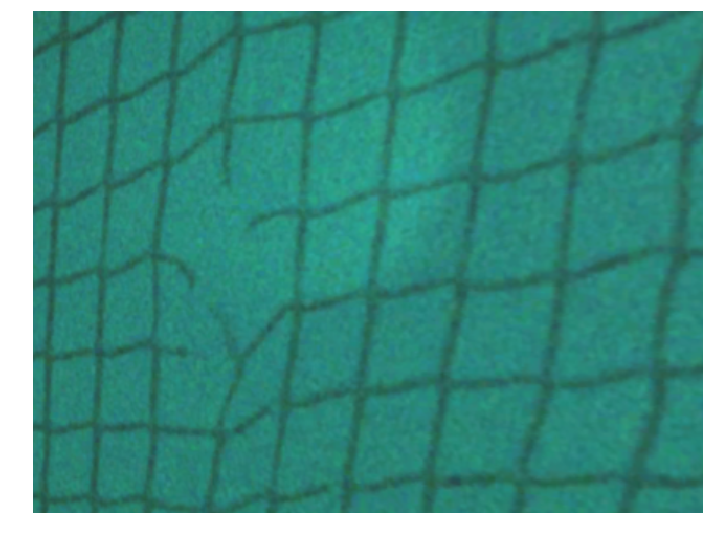

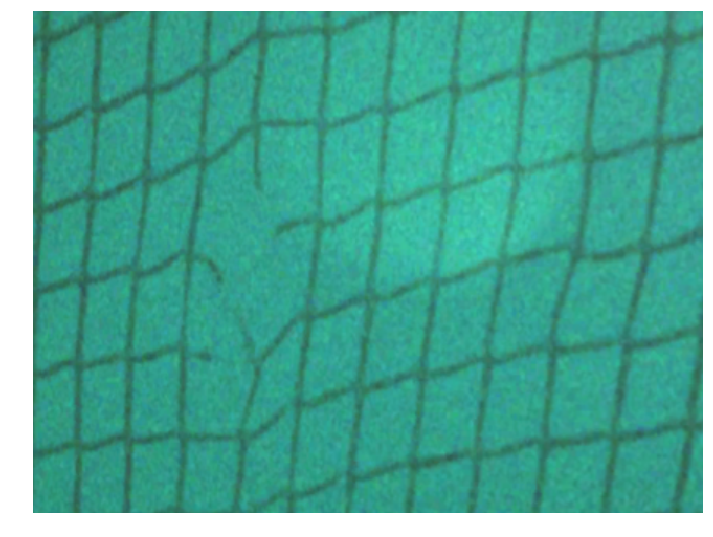

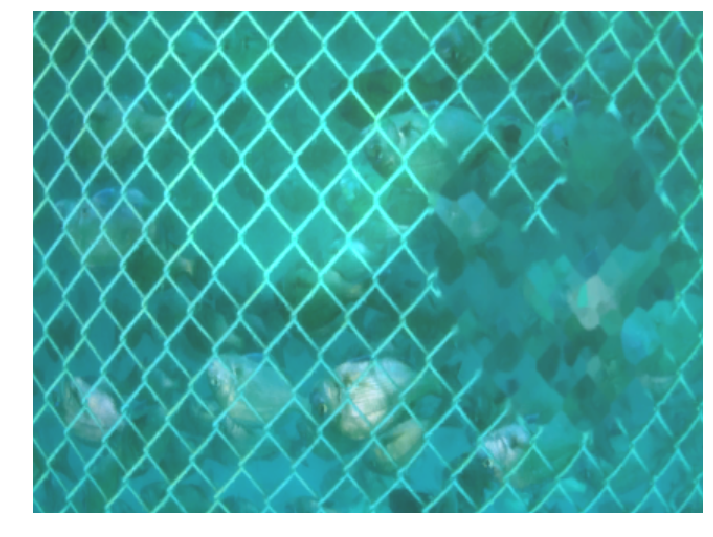

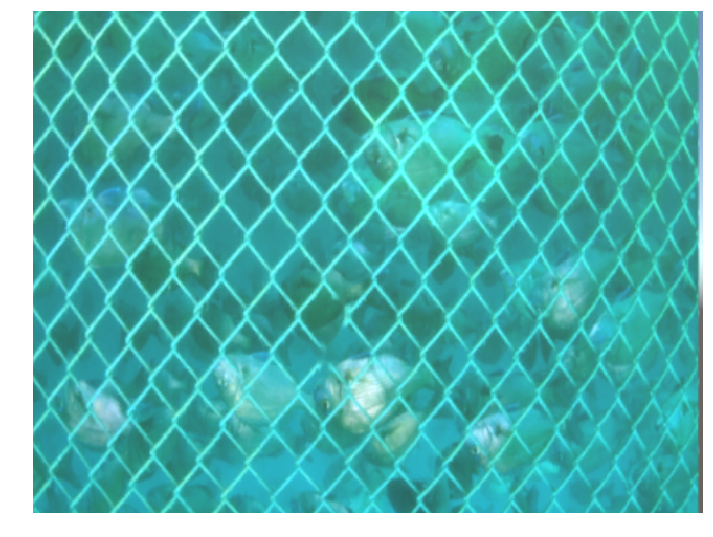

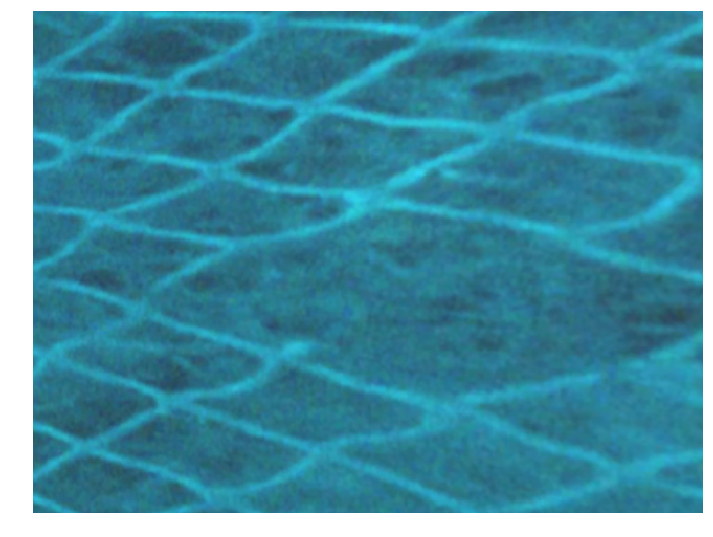

...

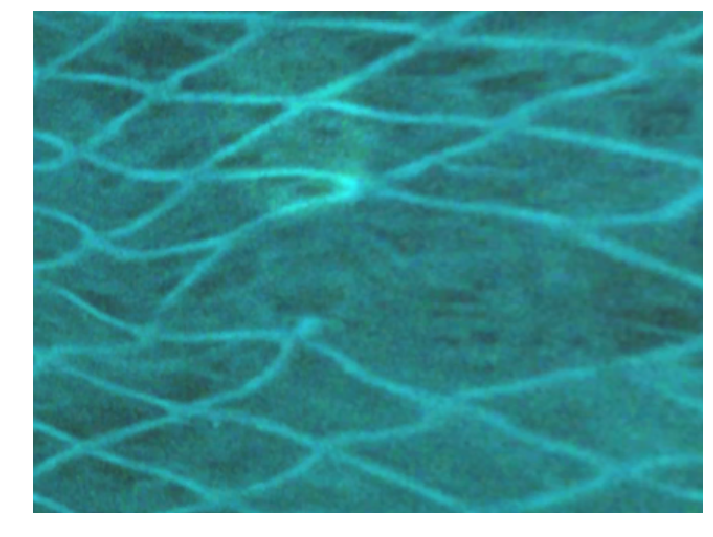

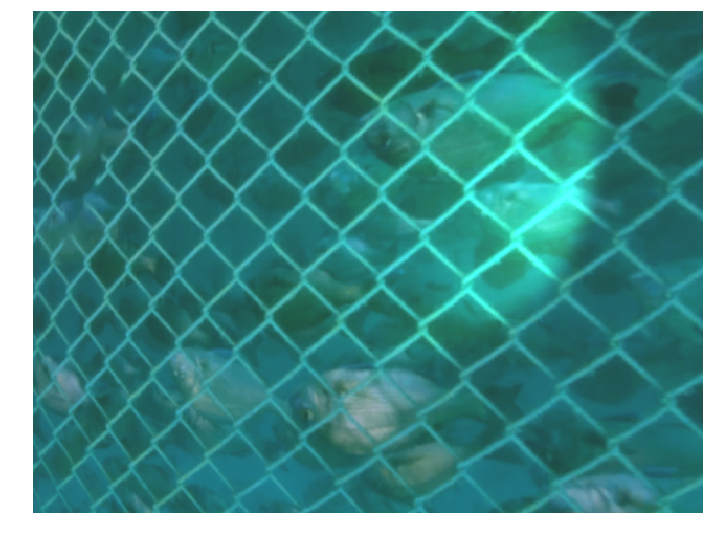

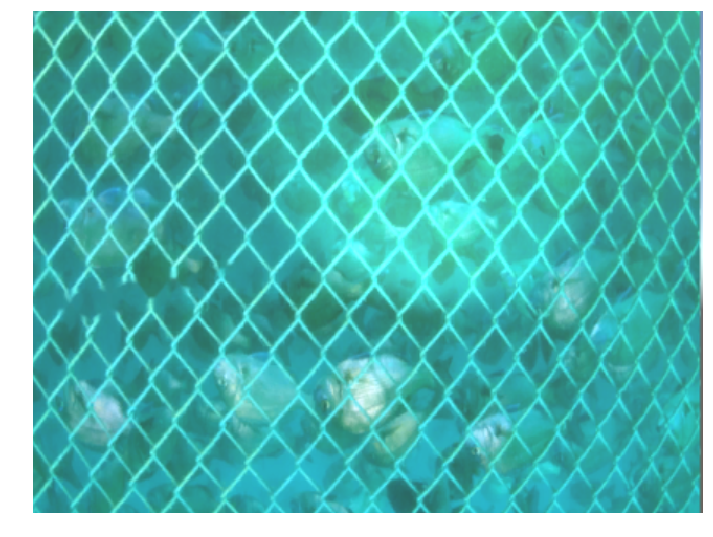

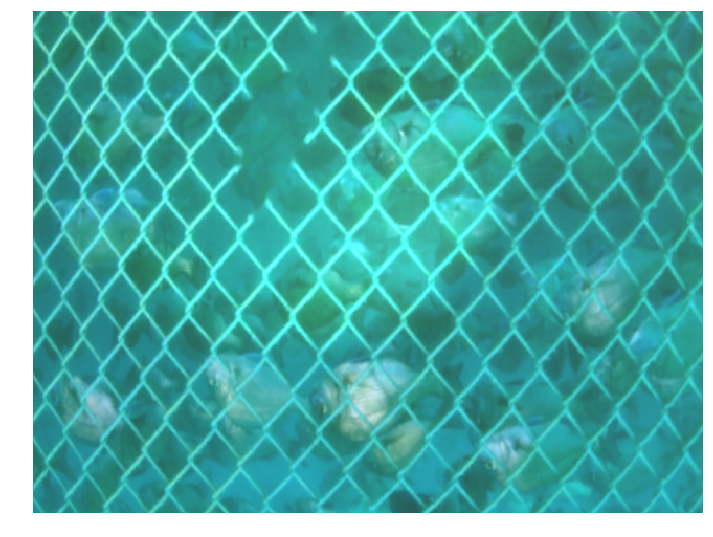

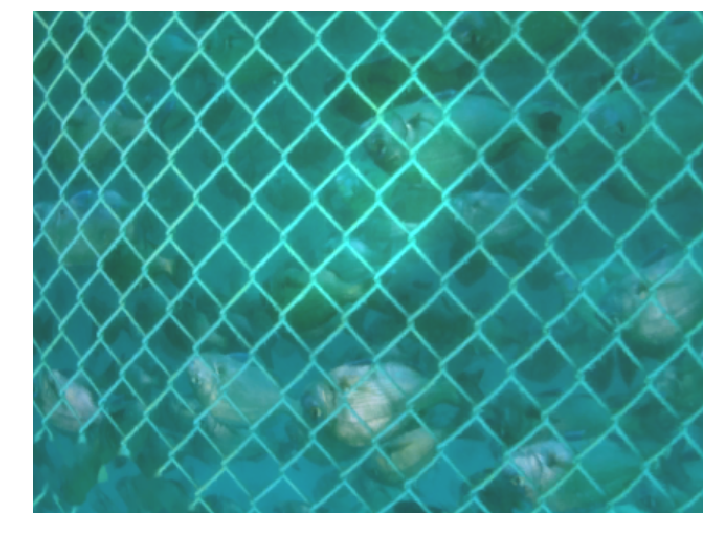

In [22]:
for i in range(len(fail_idx[0])):

    temp_img = cv2.imread(tr_data_dir['test'][fail_idx[0][i]][0])
    
    width = 12
    height = 12
    plt.figure(figsize=(width, height))
    plt.axis("off")
    plt.imshow(cv2.cvtColor(temp_img, cv2.COLOR_BGR2RGB))
    plt.show()

In [27]:
print(te_data_dir[3][0])

./data_oh/test-images/test-images_128/bite/frame90.png


In [29]:
te_data = np.zeros((len(te_data_dir), total_pix), dtype=np.float32)
te_label = np.zeros((len(te_data_dir), 1), dtype=np.int32)

for i in range(len(te_data_dir)):
    img = cv2.imread(te_data_dir[i][0])
    te_data[i][:] = cv2.resize(img, (im_width, im_height), interpolation=cv2.INTER_CUBIC).flatten()
    te_label[i] = te_data_dir[i][1]

In [30]:
te_results = np.zeros((len(te_label), 1))
with tf.device('/device:GPU:3'):

    # Evaluate the model and print results
    for i in range(len(te_label)):
        eval_input_fn = tf.estimator.inputs.numpy_input_fn(
            x={"x": te_data[i:i+1]},
            y=te_label[i:i+1],
            num_epochs=1,
            shuffle=False)
        eval_results = net_classifier.evaluate(input_fn=eval_input_fn)
        
        te_results[i] = eval_results["accuracy"]

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:23:54
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:23:54
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.021003447
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:23:54
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:23:55
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:24:01
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:24:01
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.062156957
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:24:01
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:24:02
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:24:08
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:24:08
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.07847533
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:24:08
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:24:09
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_s

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:24:15
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:24:15
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_step = 8061, loss = 0.31809813
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:24:15
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:24:15
INFO:tensorflow:Saving dict for global step 8061: accuracy = 1.0, global_s

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:24:22
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:24:22
INFO:tensorflow:Saving dict for global step 8061: accuracy = 0.0, global_step = 8061, loss = 2.4504178
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-05-02-08:24:22
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN2600_blend_2018-05-02-07-30-42/model.ckpt-8061
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-05-02-08:24:22
INFO:tensorflow:Saving dict for global step 8061: accuracy = 0.0, global_st

In [31]:
print(np.mean(te_results))

0.7466666666666667


In [32]:
fail_idx2 = np.where(te_results == 0)
print(fail_idx2[0])
print(len(fail_idx2[0]))

[37 50 51 52 53 55 56 57 59 61 62 64 65 66 67 68 69 72 74]
19


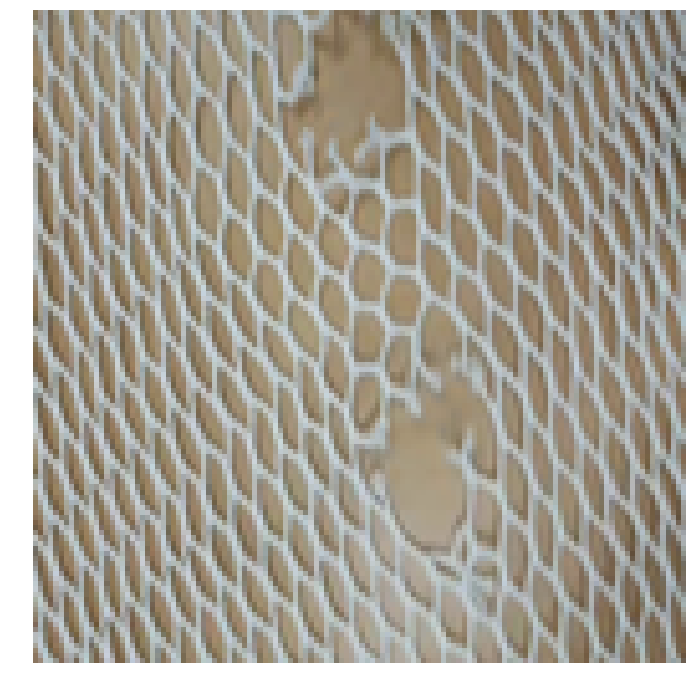

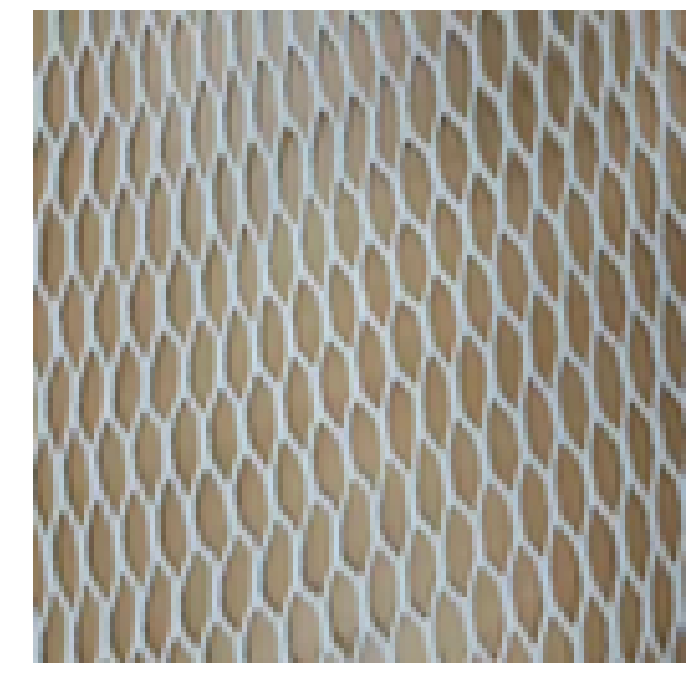

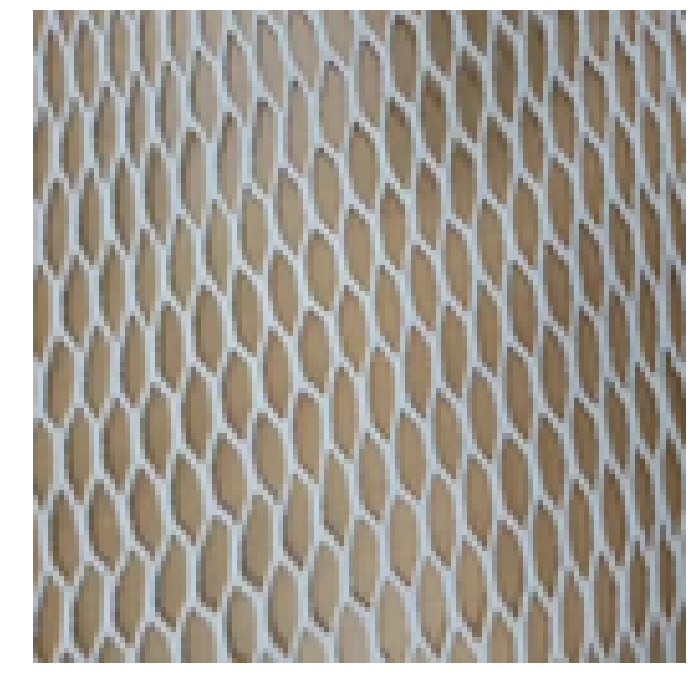

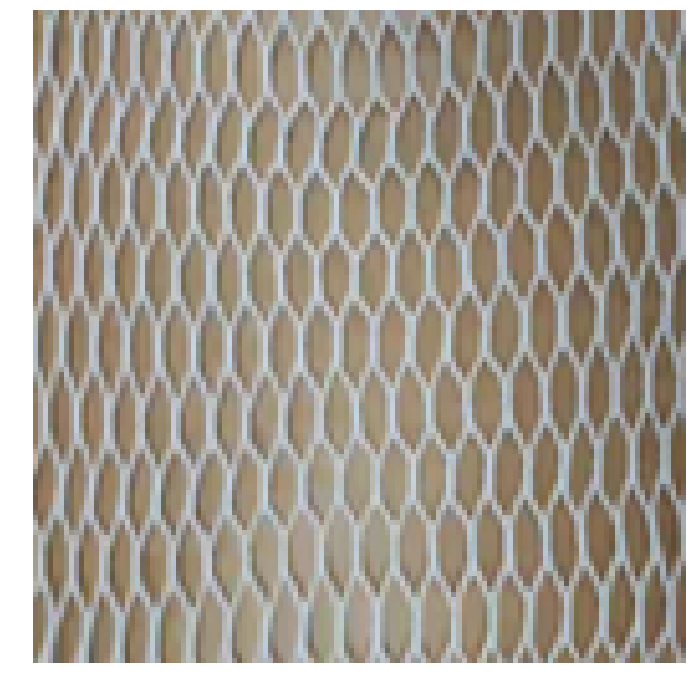

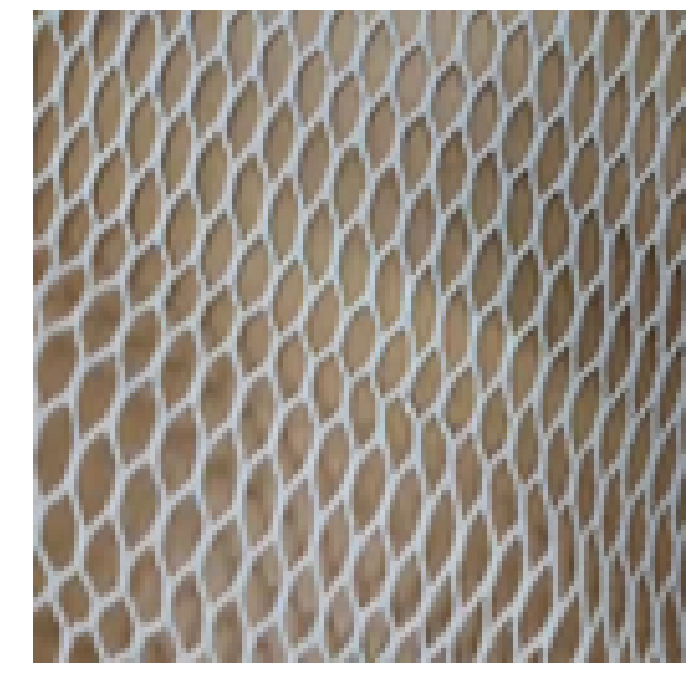

...

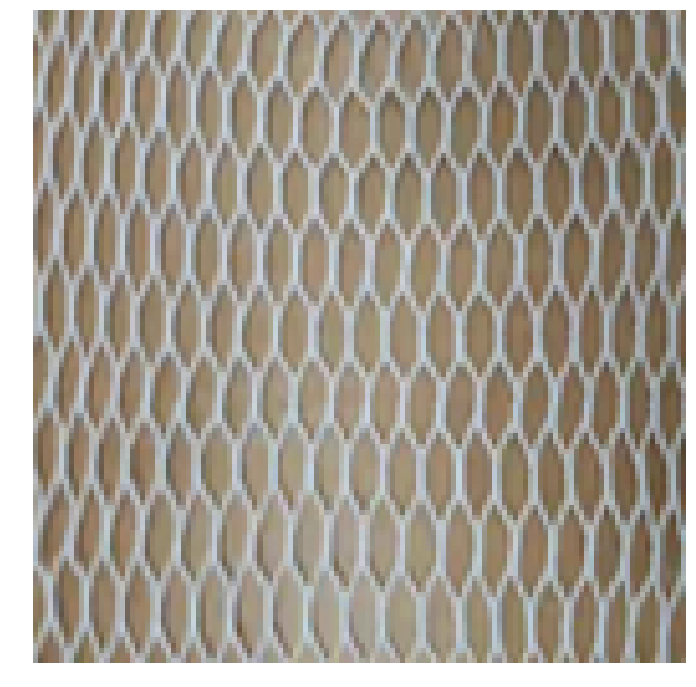

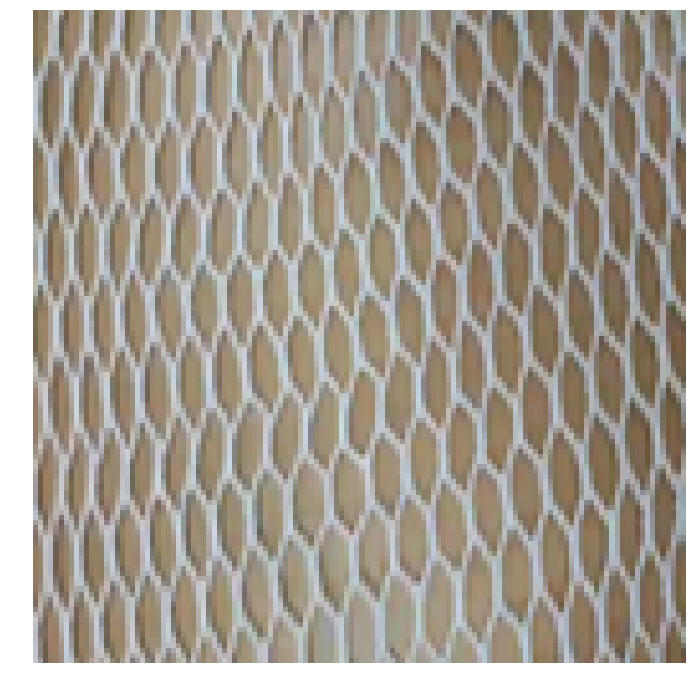

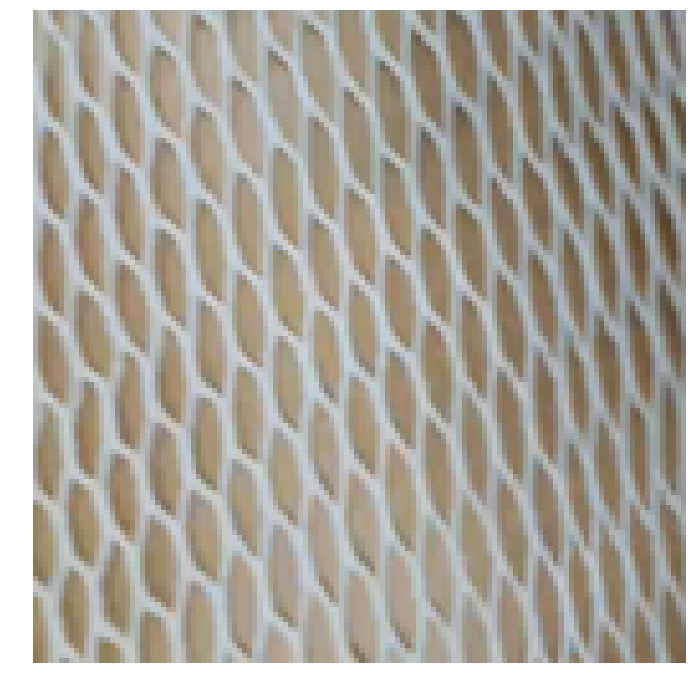

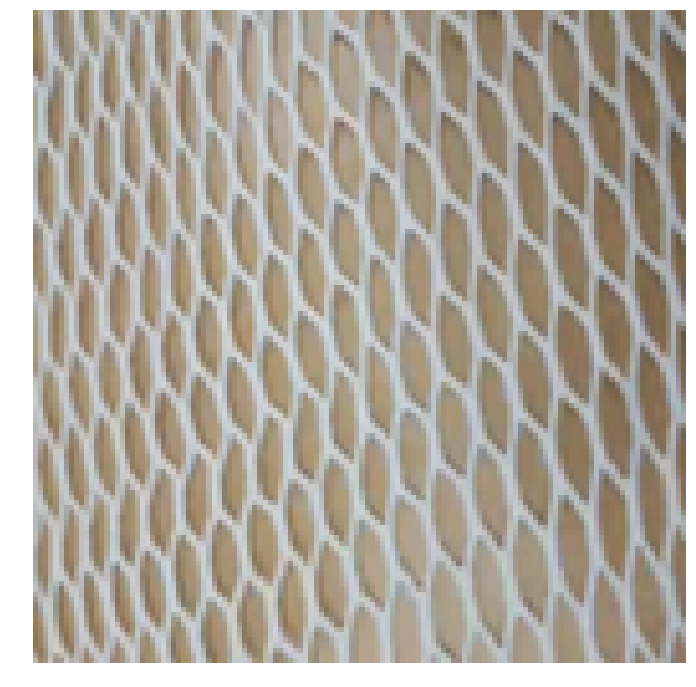

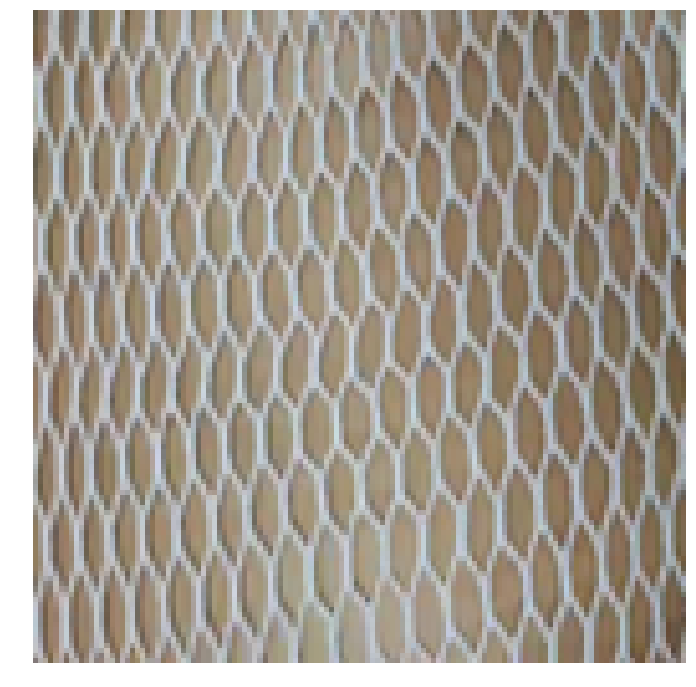

In [33]:
for i in range(len(fail_idx2[0])):

    temp_img = cv2.imread(te_data_dir[fail_idx2[0][i]][0])
    
    width = 12
    height = 12
    plt.figure(figsize=(width, height))
    plt.axis("off")
    plt.imshow(cv2.cvtColor(temp_img, cv2.COLOR_BGR2RGB))
    plt.show()

안 찢어진 사진 25개 중 18개를 찢어졌다고 판단
찢어진 사진 50개 중 1개를 안 찢어졌다고 판단